In [1]:
import numpy as np

import nibabel as nib
from nilearn import plotting, surface, datasets

import matplotlib.pyplot as plt

import os
import os.path as op

Before moving on, make sure you downloaded the HCPh-Template data available [here](https://osf.io/25jtc/). Then, extract and move the data to the desired location that should have the following structure:

```
data
├── HCPh-template-ANTs
├── HCPh-template-interpolated
└── Surfaces
```

Finally, specify the path to `data` in the `path_to_hcph_template` variable. The rest of the notebook should run smoothly from now on. You may specify if you wish to save the figures (`save_plots = True`) as well as the save location (`figure_loc = op.join('..', 'figures')`).

In [2]:
path_to_hcph_template = op.abspath("./../data")
save_plots = False

if save_plots:
    figure_loc = op.join('..', 'figures')
    os.makedirs(figure_loc, exist_ok=True)

In [3]:
# Custom gray colormap with 0 being transparent
my_gray = plt.get_cmap("gray")

n_alpha = 1
my_gray._init()
alpha_vect = [0] * n_alpha + [1] * (my_gray.N + 3 - n_alpha)

my_gray._lut[:, -1] = alpha_vect

# Plotting the first template

In [4]:
ants_path = op.join(path_to_hcph_template, "HCPh-template-ANTs")
all_ants = [op.join(ants_path, f"Affine_iteration{i}_A_tpl_template0.nii.gz") for i in range(4)]

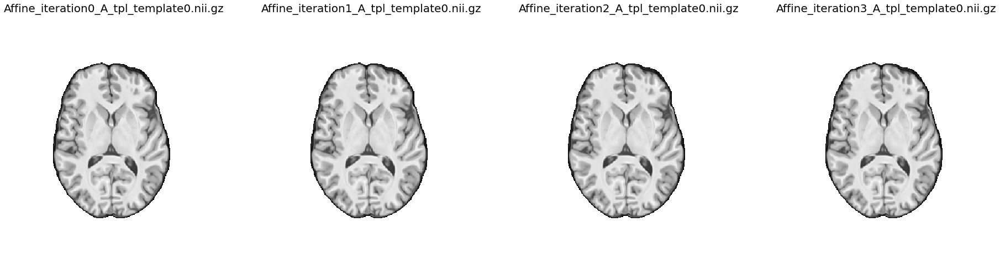

In [5]:
n_ants = len(all_ants)

z_coords = 115

fig, axes = plt.subplots(ncols=n_ants, figsize=(8*n_ants, 10))

for ax in axes:
    ax.axis("off")

for i, (ax, file) in enumerate(zip(axes, all_ants)):
    first_template_data = nib.load(file).get_fdata()[:, :, z_coords]

    rescaled_data = 255*first_template_data/first_template_data.max()
    ax.imshow(np.flip(rescaled_data.T), interpolation="none", cmap=my_gray, vmin=0, vmax=260)
    ax.set_title(op.basename(file), fontsize=20)

if save_plots:
    fig.savefig(op.join(figure_loc, "ANTs_Templates.png"), dpi=300, bbox_inches="tight", transparent=True)

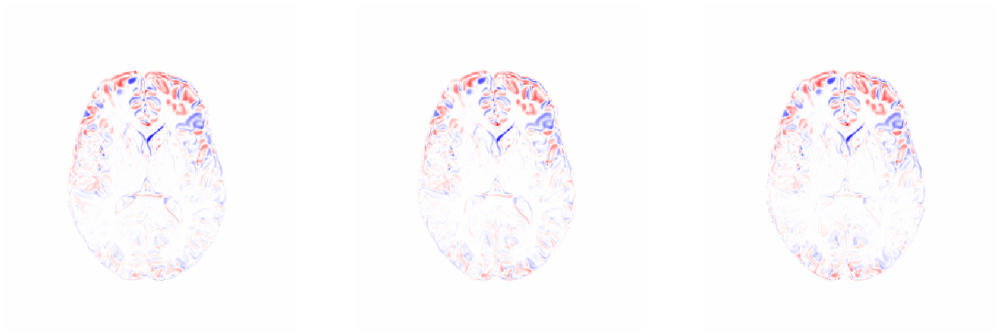

In [6]:
fig, axes = plt.subplots(ncols=n_ants-1, figsize=(8*(n_ants-1), 10))

for ax in axes:
    ax.axis("off")

for i, ax in enumerate(axes):
    #first_template_data = nib.load(path_to_ants_templates[i]).get_fdata()[:, :, z_coords]
    first_template_data = nib.load(all_ants[i]).get_fdata()[:, :, z_coords]
    second_template_data = nib.load(all_ants[i+1]).get_fdata()[:, :, z_coords]

    diff = second_template_data - first_template_data
    
    max_diff = np.abs(diff).max()
    
    ax.imshow(np.flip(diff.T), cmap="bwr", interpolation="none", vmin=-max_diff, vmax=max_diff)

if save_plots:
    fig.savefig(op.join(figure_loc, "ANTs_Templates-diff_w_previous_iter.png"), dpi=300,
                bbox_inches="tight", transparent=True)

# Plotting the final templates

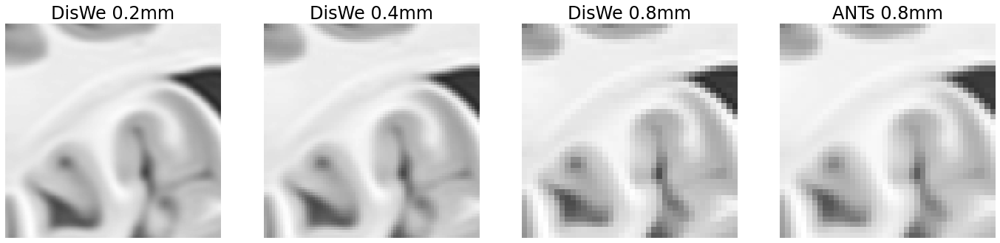

In [7]:
diswe_path = op.join(path_to_hcph_template, "HCPh-template-interpolated")

path_to_diswe_02mm = op.join(diswe_path, "res-0.2", f"distance_weighted_template_res-0.2_space-native_desc-N35DisWei1T1w.nii.gz")
path_to_diswe_04mm = op.join(diswe_path, "res-0.4", f"distance_weighted_template_res-0.4_space-native_desc-N35DisWei1T1w.nii.gz")
path_to_diswe_08mm = op.join(diswe_path, "res-0.8", f"distance_weighted_template_res-0.8_space-native_desc-N35DisWei1T1w.nii.gz")
path_to_ants_template = op.join(ants_path, f"Affine_iteration3_A_tpl_template0.nii.gz")

templates_to_show = [path_to_diswe_02mm, path_to_diswe_04mm, path_to_diswe_08mm, path_to_ants_template]

resolution_factors = [4, 2, 1, 1]

z_coords = 115
z_coords_template = [z_coords*res for res in resolution_factors]

#maxvals = [700, 14]
maxvals = [255]*len(templates_to_show)

zooms_x = [110, 150]
zooms_y = [80, 120]

fig, axes = plt.subplots(ncols=len(templates_to_show), figsize=(12*2, 10))

for ax in axes:
    ax.axis("off")

for i, (ax, z_coord_temp) in enumerate(zip(axes, z_coords_template)):
    first_template_data = nib.load(templates_to_show[i]).get_fdata()[:, :, z_coord_temp]

    zoomed_img = first_template_data[resolution_factors[i]*zooms_x[0]: resolution_factors[i]*zooms_x[1], resolution_factors[i]*zooms_y[0]: resolution_factors[i]*zooms_y[1]]
    normalized_img = 255*zoomed_img/zoomed_img.max()
    
    ax.imshow(normalized_img, cmap=my_gray, interpolation="none", vmin=0, vmax=maxvals[i])

axes[0].set_title("DisWe 0.2mm", fontsize=24)
axes[1].set_title("DisWe 0.4mm", fontsize=24)
axes[2].set_title("DisWe 0.8mm", fontsize=24)
axes[3].set_title("ANTs 0.8mm", fontsize=24)

if save_plots:
    fig.savefig(op.join(figure_loc, f"ANTs_vs_DisWe-zoom_x{zooms_x[0]}_{zooms_x[1]}y{zooms_y[0]}_{zooms_y[1]}.png"), dpi=300, bbox_inches="tight", transparent=True)

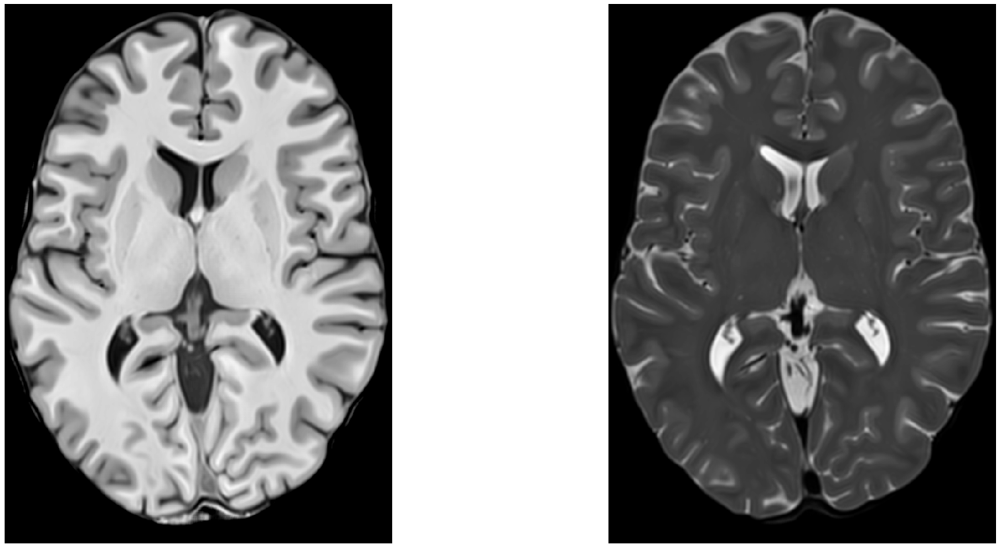

In [8]:
res = 0.2
space = "MNI04mmRigid"

fnames = [f"distance_weighted_template_res-{res:1.1f}_space-{space}_desc-N35DisWei1T{i+1}w.nii.gz" for i in range(2)]
path_to_diswe_templates = [op.join(diswe_path, f"res-{res:1.1f}", fname) for fname in fnames]

in_mni = False
if "MNI" in path_to_diswe_templates[0]:
    in_mni = True


res_factor = int(0.8//res)

if in_mni:
    xzoom = 40
    yzoom = 30
    z_coords = 103
else:
    xzoom = 55
    yzoom = 50
    z_coords = 115

z_coords_template = [res_factor*z_coords]*2
zooms = [[res_factor*xzoom, -res_factor*xzoom],
         [res_factor*yzoom, -res_factor*yzoom]]

fig, axes = plt.subplots(ncols=2, figsize=(15*2, 15))
for ax in axes:
    ax.axis("off")

maxvals = [[40, 260], [0, 255]]

for i, (ax, z_coord_temp) in enumerate(zip(axes, z_coords_template)):
    first_template_data = nib.load(path_to_diswe_templates[i]).get_fdata()[:, :, z_coord_temp]

    zoomed_img = first_template_data[zooms[0][0]:zooms[0][1], zooms[1][0]:zooms[1][1]]

    norm_img = 255*zoomed_img/zoomed_img.max()

    ax.imshow(np.flip(norm_img.T, axis=0), cmap="gray", interpolation="none", vmin=maxvals[i][0], vmax=maxvals[i][1])

if save_plots:
    res_str = f"{res*10:02.0f}"
    fig.savefig(op.join(figure_loc, f"Interp_Templates_{res_str}mm-({maxvals})"+in_mni*"-MNI"+".png"),
                dpi=600, bbox_inches="tight", transparent=True)

# Using the template as background

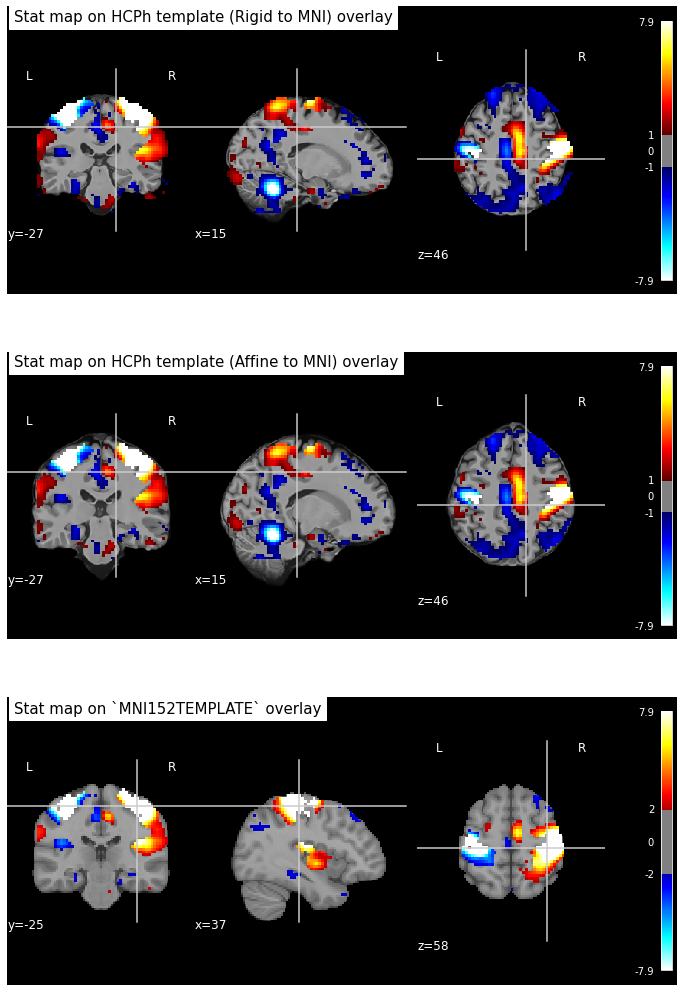

In [9]:
statmap = datasets.load_sample_motor_activation_image()

spaces = ["Rigid", "Affine"]
fnames = [f"distance_weighted_template_res-0.8_space-MNI04mm{space}_desc-N35DisWei1T1w.nii.gz" for space in spaces]

all_bgs = [op.join(diswe_path, "res-0.8", fname) for fname in fnames]
titles = ["Stat map on HCPh template (Rigid to MNI) overlay",
          "Stat map on HCPh template (Affine to MNI) overlay"]

clip_prop = 0.7

fig, axes = plt.subplots(nrows=3, figsize=(12, 6*3))

for i, (title, bg_map) in enumerate(zip(titles, all_bgs)):
    bg_img = nib.load(bg_map)
    bg_data = bg_img.get_fdata()

    # Clipping background
    bg_data[bg_data < 0] = 0
    bg_data[bg_data > clip_prop*bg_data.max()] = clip_prop*bg_data.max()

    bg_clipped = nib.Nifti1Image(bg_data, affine=bg_img.affine)

    plotting.plot_stat_map(nib.load(statmap), bg_img=bg_clipped, display_mode="ortho", threshold=1, black_bg=True,
                           title=title, axes=axes[i], interpolation="none")

plotting.plot_stat_map(nib.load(statmap), display_mode="ortho", threshold=2, black_bg=True,
                       title="Stat map on `MNI152TEMPLATE` overlay", axes=axes[-1], interpolation="none")

if save_plots:
    fig.savefig(op.join(figure_loc, "statmap-trans-v01.png"), dpi=600, facecolor="black")

### Testting multiple resolutions

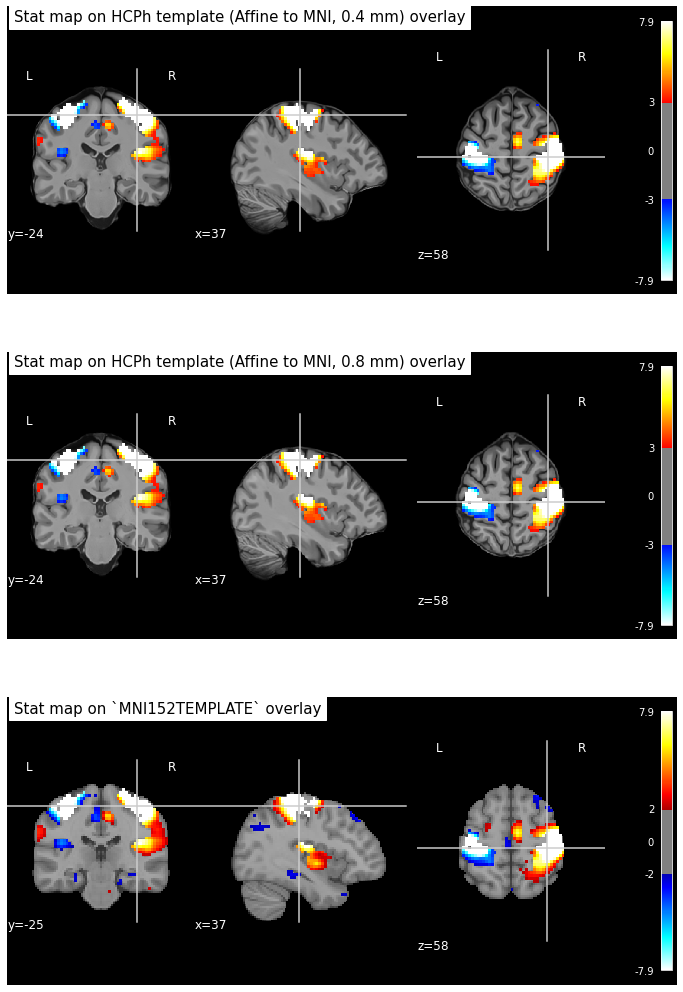

In [10]:
all_res = [4, 8]

space = "Affine"
fnames = [f"distance_weighted_template_res-0.{res}_space-MNI04mm{space}_desc-N35DisWei1T1w.nii.gz" for res in all_res]

all_bgs = [op.join(diswe_path, f"res-0.{res}", fname) for fname, res in zip(fnames, all_res)]
titles = [f"Stat map on HCPh template (Affine to MNI, 0.{res} mm) overlay" for res in all_res]

clip_prop = 0.7

fig, axes = plt.subplots(nrows=3, figsize=(12, 6*3))

for i, (title, bg_map) in enumerate(zip(titles, all_bgs)):
    bg_img = nib.load(bg_map)
    bg_data = bg_img.get_fdata()

    # Clipping background
    bg_data[bg_data < 0] = 0
    bg_data[bg_data > clip_prop*bg_data.max()] = clip_prop*bg_data.max()

    bg_clipped = nib.Nifti1Image(bg_data, affine=bg_img.affine)

    plotting.plot_stat_map(nib.load(statmap), bg_img=bg_clipped, display_mode="ortho", threshold=3, black_bg=True,
                           title=title, axes=axes[i], interpolation="none")

plotting.plot_stat_map(nib.load(statmap), display_mode="ortho", threshold=2, black_bg=True,
                       title="Stat map on `MNI152TEMPLATE` overlay", axes=axes[-1], interpolation="none")

if save_plots:
    fig.savefig(op.join(figure_loc, "statmap-res-v01.png"), dpi=600, facecolor="black")

# Surface plots

In [11]:
path_to_surf_template = op.join(path_to_hcph_template, "Surfaces/surf")

surface_file = "rh.pial"
bg_file = "rh.sulc"

path_to_surf = op.join(path_to_surf_template, surface_file)
path_to_bg = op.join(path_to_surf_template, bg_file)

In [12]:
fs_keys = ["infl_left", "pial_left", "sulc_left",  "white_left", "curv_left", "infl_right", "pial_right", "sulc_right", "white_right", "curv_right"]
hemi_key = {"left":"lh", "right":"rh"}

surf_like_fs = {}
for key in fs_keys:
    label, hemi = key.split("_")
    if "infl" in label:
        label = "inflated"
        surf = surface.load_surf_mesh(op.join(path_to_surf_template, ".".join([hemi_key[hemi], label])))
    elif ("sulc" in label) or ("curv" in label):
        surf = surface.load_surf_data(op.join(path_to_surf_template, ".".join([hemi_key[hemi], label])))
    else:
        surf = surface.load_surf_mesh(op.join(path_to_surf_template, ".".join([hemi_key[hemi], label])))
    
    surf_like_fs.update({key:surf})

# Plot surfaces

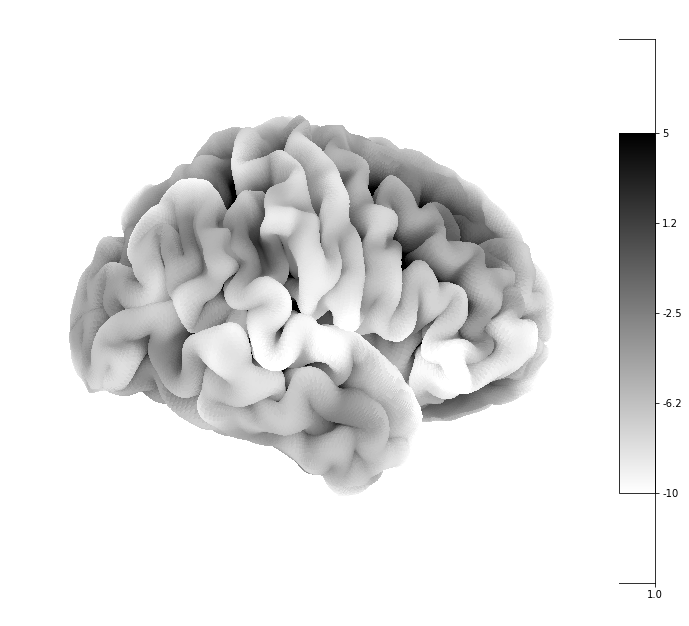

In [13]:
fig, axes = plt.subplots(figsize=(10, 10))

maxval=10

disp = plotting.plot_surf(path_to_surf, surf_map=path_to_bg, hemi="right", cmap="binary", figure=fig,
                          colorbar=True, vmin=-maxval, vmax=maxval//2, avg_method="median")

## Statmap on surface

In [14]:
view = plotting.view_img_on_surf(nib.load(statmap), threshold='90%', surf_mesh=surf_like_fs)

view

/home/acionca/miniconda3/envs/hcph/lib/python3.10/site-packages/nilearn/surface/surface.py:463: RuntimeWarning: Mean of empty slice
  texture = np.nanmean(all_samples, axis=2)
/home/acionca/miniconda3/envs/hcph/lib/python3.10/site-packages/nilearn/surface/surface.py:463: RuntimeWarning: Mean of empty slice
  texture = np.nanmean(all_samples, axis=2)


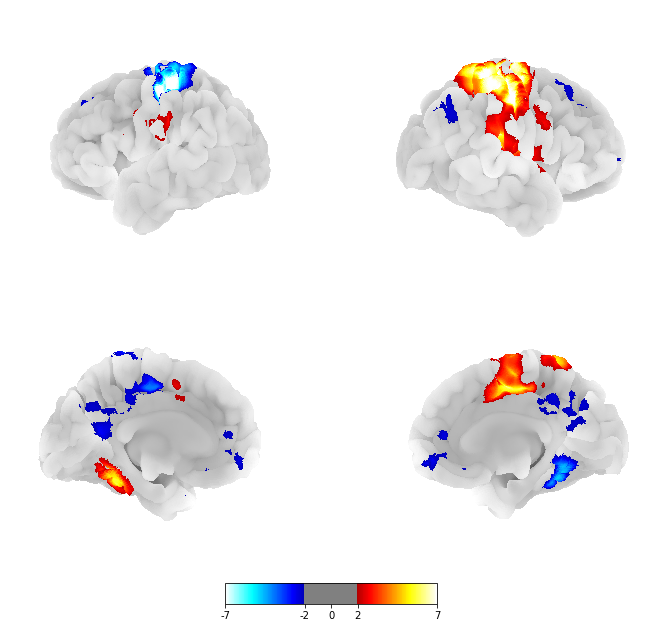

In [15]:
# Takes ~ 2min15 to plot

fig, axes = plotting.plot_img_on_surf(statmap, surf_mesh=surf_like_fs,
                                views=['lateral', 'medial'], hemispheres=['left', 'right'],
                                threshold=2, colorbar=True)

fig.set_size_inches(10, 9)

if save_plots:
    fig.savefig(op.join(figure_loc, "statmap-surf-v01.png"), dpi=600)